# Introduction to Clustering

This notebook covers the basics of k-Means clustering using the Instacart Market data. 

<hr>

### What is clustering? 

Clustering is a type of unsupervised learning that performs the task of partioning a dataset into groups called *clusters*. The goal of clustering is to partition the data in such a way that points within a single cluster are very similiar.

Clustering algorithms assign (or predict) a number to each data point, indicating which cluster that point belongs to.

*Reference: Introduction to Machine Learning with Python, pg. 168*

##### k-Means Clustering

One of the most commonly used algorithms in clustering. k-Means tries to identify cluster centers that are representative of certain regions of the data. 

2-step approach: 
1) Assign each data point to the closest cluster center 
2) Set each cluster center as the mean of the data points assigned to it 

Algorithm is finished when the assignment of instances to clusters no longer changes. When given new data points, the algorithm will assign each point to the closest cluster center. 

<br>
<hr>

##### Let's apply this algorithm to the instacart data to cluster the customers based on certain features. 

In [1]:
# Import packages 
import pandas as pd 
import plotly.express as px 
import matplotlib.pyplot as plt 

from sklearn.cluster import KMeans 
from sklearn.preprocessing import StandardScaler

In [2]:
# Load datasets 
# We will use the order_products_prior and orders csv files 

order_products = pd.read_csv(r"/Users/umreenimam/Documents/BMCC/Lesson Materials/Weeks 9 - 10/Instacart Market Basket Analysis/order_products__prior.csv", sep = ",")
orders = pd.read_csv(r"/Users/umreenimam/Documents/BMCC/Lesson Materials/Weeks 9 - 10/Instacart Market Basket Analysis/orders.csv", sep = ",")

In [4]:
# Merge order_products with orders to get customer info 
order_data = pd.merge(order_products, orders[["order_id", "user_id", "order_number", "days_since_prior_order"]], on = "order_id")
order_data.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,order_number,days_since_prior_order
0,2,33120,1,1,202279,3,8.0
1,2,28985,2,1,202279,3,8.0
2,2,9327,3,0,202279,3,8.0
3,2,45918,4,1,202279,3,8.0
4,2,30035,5,0,202279,3,8.0


In [5]:
# Calculate the following: reorder percentage, average order size, average days between orders by grouping by 'user_id'
customer_behavior = order_data.groupby("user_id").agg(
    total_orders = ("reordered", "size"),
    reorder_counts = ("reordered", "sum"), 
    average_order_size = ("order_id", "size"),
    average_days_between_orders = ("days_since_prior_order", "mean")
).reset_index()

In [6]:
# Calculate reorder percentage
customer_behavior["reorder_percentage"] = (customer_behavior["reorder_counts"] / customer_behavior["total_orders"]) * 100

# Fill NaN values in average_days_between_orders with 0 
customer_behavior["average_days_between_orders"].fillna(0, inplace = True)

In [7]:
# Select columns (features) for clustering 
X = customer_behavior[["reorder_percentage", "total_orders", "average_order_size", "average_days_between_orders"]]

# Standaridze features 
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

##### Elbow method 

A method to help with finding the most optimal number of clusters (k). THis is done by plotting the within-cluster-sum-of-square (wcss) values on the y-axis against the number of clusters (k) on the x-axis. The optimal k value is the point at which the graph forms an elbow where the rate of variance decreases sharply and levels off.

In [9]:
# Perform elbow method 
ks = []
k_range = range(1, 11)

for k in k_range:
    kmeans = KMeans(n_clusters = k, random_state = 42, n_init = "auto")
    kmeans.fit(X_scaled)
    ks.append(kmeans.inertia_)

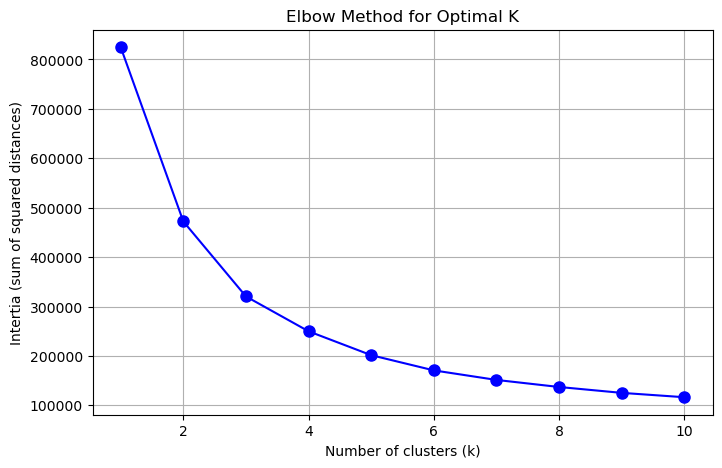

In [12]:
# Plot elbow 
plt.figure(figsize = (8, 5))
plt.plot(k_range, ks, "bo-", markersize = 8)
plt.title("Elbow Method for Optimal K")
plt.xlabel("Number of clusters (k)")
plt.ylabel("Intertia (sum of squared distances)")
plt.grid(True)
plt.show()

From the plot above, 3 appears to be the most optimal 'k'

In [13]:
# Set cluster number
clusters = 3 

# Apply Kmeans clustering with optimal cluster number
kmeans = KMeans(n_clusters = clusters, random_state = 42, n_init = "auto")
customer_behavior["cluster"] = kmeans.fit_predict(X_scaled)

Now that we run the k-Means algorithm on the customer data, let's take a look at the customer_behavior dataframe with the new 'cluster' column

In [14]:
customer_behavior.head()

,user_id,total_orders,reorder_counts,average_order_size,average_days_between_orders,reorder_percentage,cluster
0,1,59,41,59,20.259259,69.491525,0
1,2,195,93,195,15.967033,47.692308,0
2,3,88,55,88,11.487179,62.500000,0
3,4,18,1,18,15.357143,5.555556,1
4,5,37,14,37,14.500000,37.837838,1


In [17]:
# Visualize clusters using scatter plot (reorder_percentage vs. total_orders)
fig = px.scatter(customer_behavior, x = "reorder_percentage", y = "total_orders", color = "cluster", 
                 size = "average_order_size", hover_data = ["average_days_between_orders"],
                 title = "Customer Clusters Based on Reorder Behavior", 
                 labels = {"reorder_percentage": "Reorder Percentage", "total_orders": "Total Orders"},
                 color_continuous_scale = px.colors.sequential.Viridis)

fig.show()

Let's also get a customer profile based on average metrics for each cluster

In [18]:
cluster_profile = customer_behavior.groupby("cluster").agg(
    avg_reorder_percentage = ("reorder_percentage", "mean"),
    avg_total_orders = ("total_orders", "mean"),
    avg_order_size = ("average_order_size", "mean"),
    avg_days_between_orders = ("average_days_between_orders", "mean")
).reset_index()

cluster_profile.head()

,cluster,avg_reorder_percentage,avg_total_orders,avg_order_size,avg_days_between_orders
0,0,52.975247,153.808532,153.808532,11.518447
1,1,27.267746,55.036815,55.036815,21.131303
2,2,72.191254,676.485327,676.485327,7.679524
